# Exploration on the data set of electricity consumption

Dataset: https://www.kaggle.com/aditya230688/jhts-forecasting

We first explore the data of electricity consumption.

In [1]:
import pandas as pd
from sklearn.preprocessing import LabelEncoder
from statsmodels.tsa.seasonal import seasonal_decompose
import plotly.graph_objects as go
import plotly.express as px
from plotly.subplots import make_subplots
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
import matplotlib.pyplot as plt

Loading the data

In [2]:
df = pd.read_csv('train_6BJx641.csv')

In [3]:
df = df.set_index('datetime')

We transform the categorial data, 'var2', with 'A', 'B' and 'C' into the integers 0, 1 and 2.

In [4]:
le = LabelEncoder()
le.fit(df['var2'])
df['var2'] =le.transform(df['var2'])

df = df.drop(['ID'], axis=1)

In [5]:
df.head()

,temperature,var1,pressure,windspeed,var2,electricity_consumption
datetime,,,,,,
2013-07-01 00:00:00,-11.4,-17.1,1003.0,571.910,0,216.0
2013-07-01 01:00:00,-12.1,-19.3,996.0,575.040,0,210.0
2013-07-01 02:00:00,-12.9,-20.0,1000.0,578.435,0,225.0
2013-07-01 03:00:00,-11.4,-17.1,995.0,582.580,0,216.0
2013-07-01 04:00:00,-11.4,-19.3,1005.0,586.600,0,222.0


# Plot of electricity consumption versus time

In [6]:
fig = px.line(df, y="electricity_consumption")
fig.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(count=1, label="1m", step="month", stepmode="backward"),
            dict(count=6, label="6m", step="month", stepmode="backward"),
            dict(count=1, label="YTD", step="year", stepmode="todate"),
            dict(count=1, label="1y", step="year", stepmode="backward"),
            dict(step="all")
        ])
    )
)
fig.show()

# Plot of the featues versus time

In [7]:
column = list(df.columns)
column.remove('electricity_consumption')
column = ['electricity_consumption'] + column

In [8]:
fig = make_subplots(rows=len(column), cols=1, subplot_titles=column)

for count, col in enumerate(column):
    fig.add_trace(go.Scatter(x=df.index, y=df[col]),
              row=count+1, col=1)
fig['layout'].update(height=1200, width=800)
fig.show()

# Correlation between the data

In [9]:
fig = px.imshow(df.corr().round(1), text_auto=True)
fig.show()

# Autocorrelation of electricity_consumption

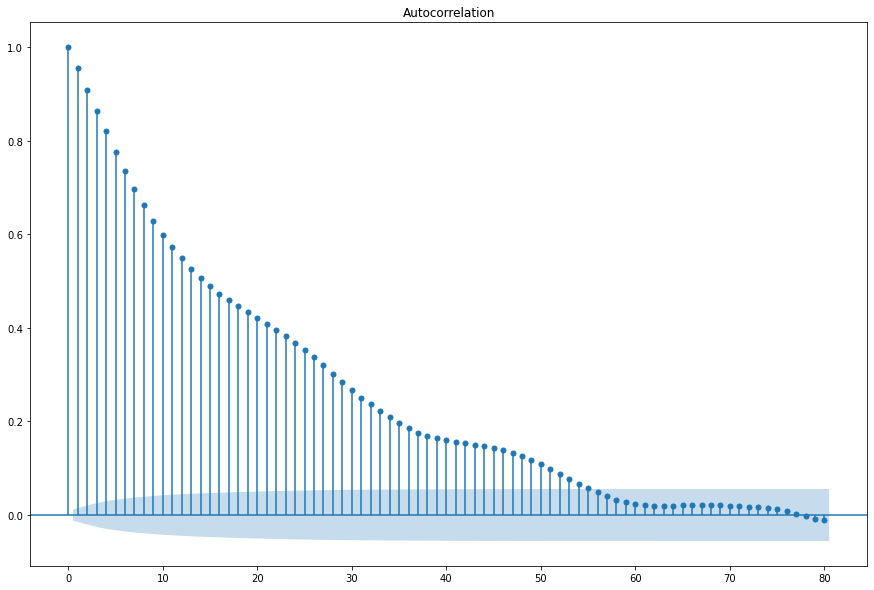

In [10]:
fig, ax = plt.subplots(figsize=(15, 10))
ax = plot_acf(df['electricity_consumption'], lags=80, ax=ax)
plt.show()

# Trend and seasonal decomposition

We adopt the package, statsmodels.tsa.seasonal, to decompose the time series into the parts of trend, seaonsl and their residuals.

y(t) = Trend + Seasonal + Residual

In [11]:
trend = pd.DataFrame()
seasonal = pd.DataFrame()
resid = pd.DataFrame()
for i in df.columns:
    result = seasonal_decompose(df[i].dropna(), model='additive', period=24)
    trend = pd.concat([trend, result.trend], axis=1)
    seasonal = pd.concat([seasonal, result.seasonal], axis=1)
    resid = pd.concat([resid, result.resid], axis=1)
    
trend.columns = df.columns
seasonal.columns = df.columns
resid.columns = df.columns

In [12]:
std = resid['electricity_consumption'].std()*2
index = list(resid['electricity_consumption'].where(resid['electricity_consumption']>std).dropna().index)
index = index + list(resid['electricity_consumption'].where(resid['electricity_consumption']<-std).dropna().index)
for i in index:
    resid['electricity_consumption'][i] = std

In [13]:
fig = make_subplots(rows=3, cols=1, subplot_titles=["Trend", "Seasonal", "Residual"])

fig.add_trace(go.Scatter(x=trend.index, y=trend['electricity_consumption']),
              row=1, col=1)

fig.add_trace(go.Scatter(x=trend.index, y=seasonal['electricity_consumption']),
              row=2, col=1)

fig.add_trace(go.Scatter(x=trend.index, y=resid['electricity_consumption']),
              row=3, col=1)
fig['layout'].update(height=1000, width=900)
fig.show()

# Autocorrelation of trend

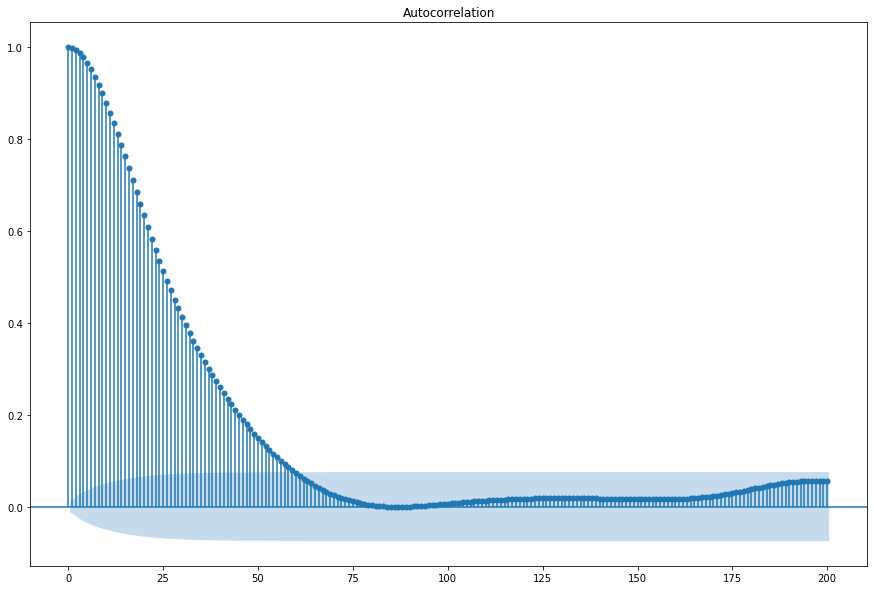

In [14]:
fig, ax = plt.subplots(figsize=(15, 10))
ax = plot_acf(trend['electricity_consumption'].dropna(), lags=200, ax=ax)
plt.show()

# Stationarity of residual of "electricity_consumption"

https://www.statsmodels.org/devel/examples/notebooks/generated/stationarity_detrending_adf_kpss.html

In [15]:
from statsmodels.tsa.stattools import adfuller

def adf_test(timeseries):
    print("Results of Dickey-Fuller Test:")
    dftest = adfuller(timeseries, autolag="AIC")
    dfoutput = pd.Series(
        dftest[0:4],
        index=[
            "Test Statistic",
            "p-value",
            "#Lags Used",
            "Number of Observations Used",
        ],
    )
    for key, value in dftest[4].items():
        dfoutput["Critical Value (%s)" % key] = value
    print(dfoutput)

In [16]:
adf_test(resid['electricity_consumption'].dropna())

Results of Dickey-Fuller Test:
Test Statistic                   -21.424122
p-value                            0.000000
#Lags Used                        48.000000
Number of Observations Used    26423.000000
Critical Value (1%)               -3.430598
Critical Value (5%)               -2.861649
Critical Value (10%)              -2.566828
dtype: float64


Based on the p-value, there is evidence for rejecting the null hypothesis. The series, resid['electricity_consumption'], is stationary.

# Autocorrelation of residual

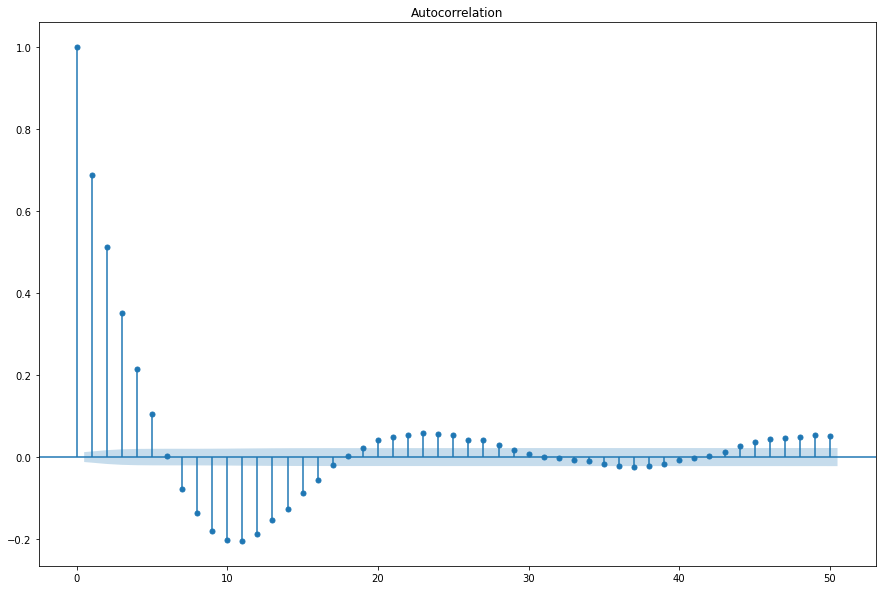

In [17]:
fig, ax = plt.subplots(figsize=(15, 10))
ax = plot_acf(resid['electricity_consumption'].dropna(), lags=50, ax=ax)
plt.show()

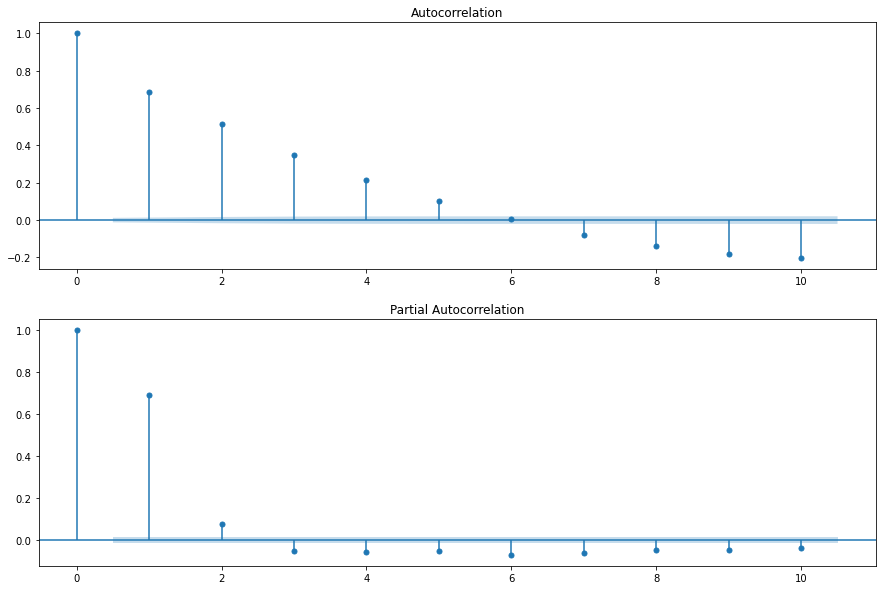

In [18]:
fig, (ax1, ax2) = plt.subplots(2,1, figsize=(15, 10))
plot_acf(resid['electricity_consumption'].dropna(), lags=10, ax=ax1)
plot_pacf(resid['electricity_consumption'].dropna(), lags=10, ax=ax2)
plt.show()

Save the data for the later use.

In [19]:
trend = trend.fillna(method='bfill').fillna(method='ffill')
seasonal = seasonal.fillna(method='bfill').fillna(method='ffill')
resid = resid.fillna(method='bfill').fillna(method='ffill')

In [20]:
trend.to_csv('trend.csv')
seasonal.to_csv('seasonal.csv')
resid.to_csv('residual.csv')